<a href="https://colab.research.google.com/github/brunelliMichele/py.tatine/blob/main/Resnet50_2_0.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
#IMPORT LIBRARIES
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

import torch
import torchvision.models as models
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
from PIL import Image


import os
import glob
from tqdm.notebook import tqdm


In [2]:
!unzip Data_example.zip #unzip dataset

Archive:  Data_example.zip
   creating: training/
  inflating: training/.DS_Store      
  inflating: __MACOSX/training/._.DS_Store  
   creating: training/antelope/
  inflating: __MACOSX/training/._antelope  
   creating: training/Arctic_fox/
  inflating: __MACOSX/training/._Arctic_fox  
   creating: training/American_chameleon/
  inflating: __MACOSX/training/._American_chameleon  
  inflating: training/antelope/2c11ae88c0.jpg  
  inflating: __MACOSX/training/antelope/._2c11ae88c0.jpg  
  inflating: training/antelope/9e39fc9334.jpg  
  inflating: __MACOSX/training/antelope/._9e39fc9334.jpg  
  inflating: training/antelope/73c2ef82e2.jpg  
  inflating: __MACOSX/training/antelope/._73c2ef82e2.jpg  
  inflating: training/antelope/9acc1d8400.jpg  
  inflating: __MACOSX/training/antelope/._9acc1d8400.jpg  
  inflating: training/antelope/03d7fc0888.jpg  
  inflating: __MACOSX/training/antelope/._03d7fc0888.jpg  
  inflating: training/antelope/0fe7076f06.jpg  
  inflating: __MACOSX/training/a

In [3]:
root_dir = 'training' #access training
image_paths = []
for class_folder in os.listdir(root_dir):
    class_folder_path = os.path.join(root_dir, class_folder)
    if os.path.isdir(class_folder_path):
        for image_file in glob.glob(os.path.join(class_folder_path, '*.jpg')): # Assuming images are JPG
            image_paths.append(image_file) #load path images in all folders of training set

print(f"Found {len(image_paths)} images.")

Found 36 images.


In [4]:
#CHECK: display random images
selected_image_paths = np.random.choice(image_paths, 30)

_,_ = plt.subplots(15, 2, figsize = (20, 500))

for i, image_path in enumerate(selected_image_paths):
    plt.subplot(15, 2, i+1)
    img = Image.open(image_path)
    img = np.array(img)
    plt.imshow(img)

plt.show()

In [13]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
device

'cpu'

Resnet50 for feature generation!

1. create new model by removing fully Connected layers in resnet50 in following way
2. output vector of new model can be used as feature

In [6]:
#import pretrained resnet
resnet = models.resnet50(pretrained=True)
#create new model by droping final layer of resnet50
model = nn.Sequential(*list(resnet.children())[:-1]).to(device)

/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 110MB/s]


now we want to pass these all images through our model and save output vector. then we can simply compare theses feature vectors of two images and return a similarity score using cosing similarity function

In [7]:
def read_image(path, to_float=False):
    img = Image.open(path)
    if to_float:
        img = np.array(img).astype(np.float32)

    return img

#read_image_batch = np.vectorize(read_image)

def generate_features(image_path):

    img = read_image(image_path, to_float=True)
    img = torch.tensor(img).to(device).unsqueeze(0)
    img = torch.einsum('bwhc->bcwh', img)

    features = model(img)
    features = torch.einsum('bijk->i', features)

    return features



first, we want to save feature vectors for all images

In [8]:
features = torch.zeros(len(image_paths), 2048)
for i, path in enumerate(tqdm(image_paths)):
    #getting name of image in path
    file_name = path.split('.')[0].split('/')[-1]

    #calculate feature vector
    feature = generate_features(path)
    feature = feature.detach().cpu().numpy()
    #save feature vector to .npy file with same name of image file
    np.save(file_name+'.npy', feature)

  0%|          | 0/36 [00:00<?, ?it/s]

In [9]:
#loading path for feature files
feature_paths = glob.glob('*.npy')
len(feature_paths)

36

In [10]:
def get_similarity(feature_path, *inp_feature):
    #print(feature_path)
    target_feature = np.load(feature_path)
    similarity = np.dot(inp_feature, target_feature) / (np.linalg.norm(inp_feature)*np.linalg.norm(target_feature))

    return similarity

#get_similarities = np.vectorize(get_similarity, signature='(n), (k) -> ()')

def get_k_similar_images(inp_path, feature_paths, k=5):
    inp_feature = generate_features(inp_path)
    inp_feature = inp_feature.detach().cpu().numpy()

    similarities = []
    for feature_path in feature_paths:
        similarities.append(get_similarity(feature_path, inp_feature))

    similarities = np.array(similarities).reshape(-1, )

    # Return the indices of the top k similar images
    return np.argsort(-similarities)[:k]

def plot_k_images(indexes, k=5):
    similar_image_paths = []
    for item in indexes:
        feature_path = feature_paths[item]
        image_name = feature_path.split('.')[0].split('/')[-1]
        image_path = [image_path for image_path in image_paths if image_name in image_path][0]
        similar_image_paths.append(image_path)

    print(f'Top {k} Similar Images:')
    # Calculate the number of rows needed for the plot
    num_rows = (k + 1) // 2
    _, _ = plt.subplots(num_rows, 2, figsize = (20, 5 * num_rows)) # Adjust figsize based on number of rows
    for i, image_path in enumerate(similar_image_paths):
        plt.subplot(num_rows, 2, i+1)
        img = read_image(image_path)
        plt.imshow(img)
    plt.show()

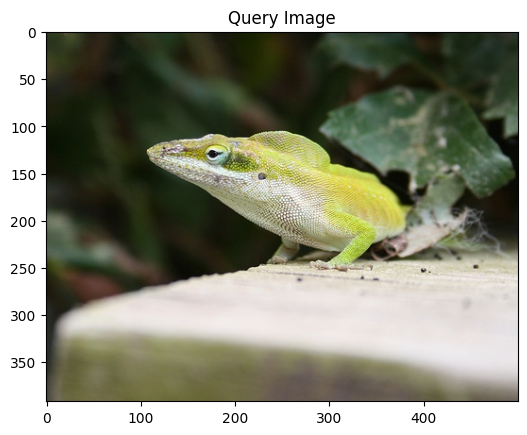

Top 5 Similar Images:


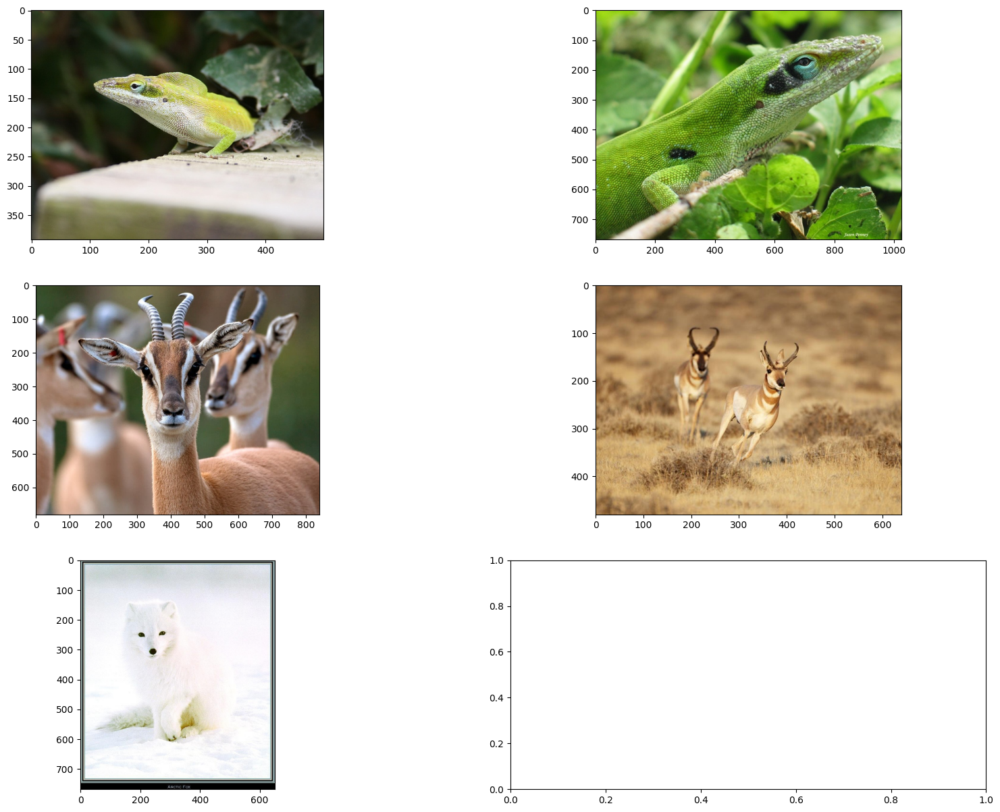

In [11]:
sample_image_path = np.random.choice(image_paths)
sample_image = read_image(sample_image_path)
plt.title('Query Image')
plt.imshow(sample_image)
plt.show()

k=5
indexes = get_k_similar_images(sample_image_path, feature_paths, k)
plot_k_images(indexes, k)